<h1><center>COVID-19 Dynamic Charts - World</center></h1>

## Table of Contents<a name='0'></a>
1. [Import Modules in Python](#1)
2. [Load Data to Python](#2)
3. [Data Processing](#3)
4. [Create COVID-19 Dynamic Charts](#4)
5. [Flatten the Curve](#5)

### 1. Import Modules in Python<a name='1'></a>
[Return to content](#0)

In [1]:
import pandas as pd
print('Current pandas version: %s'%(pd.__version__) )

import pyecharts
print('Current pyecharts version: %s'%(pyecharts.__version__) )

import numpy as np

# 更新之后控制台会出现 PendingDeprecationWarning 的提示。
# 如需关闭，请在核心代码前加入如下代码：
try:
    from pyecharts.globals import WarningType
    WarningType.ShowWarning = False
except:
    pass

from pyecharts import options as opts
from pyecharts.charts import Map, Timeline,Bar

import seaborn as sns
print('Current seaborn version: %s'%(sns.__version__) )
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

Current pandas version: 1.1.3
Current pyecharts version: 1.9.0
Current seaborn version: 0.11.0


In [73]:
pd.set_option('display.max_rows', 20)
pd.set_option('display.max_columns', 15)
pd.set_option('display.max_colwidth', 1000)

### 2. Load Data to Python<a name='2'></a>
[Return to content](#0)

In [74]:
df=pd.read_csv('./data/time_series_covid19_confirmed_global.csv')

In [75]:
df.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,...,7/19/21,7/20/21,7/21/21,7/22/21,7/23/21,7/24/21,7/25/21
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,...,141489,142414,142414,143183,143439,143439,143439
1,NaN,Albania,41.15330,20.168300,0,0,0,...,132697,132740,132763,132797,132828,132853,132875
2,NaN,Algeria,28.03390,1.659600,0,0,0,...,154486,155784,157005,158213,159563,160868,162155
3,NaN,Andorra,42.50630,1.521800,0,0,0,...,14359,14379,14379,14464,14498,14498,14498
4,NaN,Angola,-11.20270,17.873900,0,0,0,...,40906,41061,41227,41405,41405,41736,41780


In [76]:
df.shape

(279, 555)

In [77]:
df.dtypes

Province/State     object
Country/Region     object
Lat               float64
Long              float64
1/22/20             int64
                   ...   
7/21/21             int64
7/22/21             int64
7/23/21             int64
7/24/21             int64
7/25/21             int64
Length: 555, dtype: object

### 3. Data Processing<a name='3'></a>
[Return to content](#0)

#### Overview

In [78]:
df.isnull().any(None)

True

#### Check Missing Values

In [79]:
na = df.isnull().any(0)
na[na == True]

Province/State    True
Lat               True
Long              True
dtype: bool

In [80]:
#Investigate into missing values
df.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,...,7/19/21,7/20/21,7/21/21,7/22/21,7/23/21,7/24/21,7/25/21
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,...,141489,142414,142414,143183,143439,143439,143439
1,NaN,Albania,41.15330,20.168300,0,0,0,...,132697,132740,132763,132797,132828,132853,132875
2,NaN,Algeria,28.03390,1.659600,0,0,0,...,154486,155784,157005,158213,159563,160868,162155
3,NaN,Andorra,42.50630,1.521800,0,0,0,...,14359,14379,14379,14464,14498,14498,14498
4,NaN,Angola,-11.20270,17.873900,0,0,0,...,40906,41061,41227,41405,41405,41736,41780


#### Drop columns

In [81]:
#['Province/State','Lat','Long'], no need to use for the sake of visualizing
df = df.drop(columns = ['Province/State','Lat','Long'])

#### Aggregate data to Country level

In [82]:
df[df['Country/Region'] == 'China'] # we see more than one columns because there are provinces in China

,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,7/19/21,7/20/21,7/21/21,7/22/21,7/23/21,7/24/21,7/25/21
58,China,1,9,15,39,60,70,...,1008,1008,1008,1008,1008,1008,1008
59,China,14,22,36,41,68,80,...,1085,1085,1085,1085,1085,1085,1086
60,China,6,9,27,57,75,110,...,601,601,601,601,601,601,601
61,China,1,5,10,18,35,59,...,710,710,711,711,711,719,724
62,China,0,2,2,4,7,14,...,196,196,197,197,197,198,198
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87,China,0,0,0,0,0,0,...,1,1,1,1,1,1,1
88,China,0,0,0,0,0,0,...,0,0,0,0,0,0,0
89,China,0,2,2,3,4,5,...,980,980,980,980,980,980,980
90,China,1,2,5,11,16,26,...,648,648,678,691,691,703,721


In [83]:
dfc = df.groupby('Country/Region').sum()
dfc

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,...,7/19/21,7/20/21,7/21/21,7/22/21,7/23/21,7/24/21,7/25/21
Country/Region,,,,,,,,,,,,,,,
Afghanistan,0,0,0,0,0,0,0,...,141489,142414,142414,143183,143439,143439,143439
Albania,0,0,0,0,0,0,0,...,132697,132740,132763,132797,132828,132853,132875
Algeria,0,0,0,0,0,0,0,...,154486,155784,157005,158213,159563,160868,162155
Andorra,0,0,0,0,0,0,0,...,14359,14379,14379,14464,14498,14498,14498
Angola,0,0,0,0,0,0,0,...,40906,41061,41227,41405,41405,41736,41780
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Vietnam,0,2,2,2,2,2,2,...,60180,65607,71144,78269,78269,94913,101173
West Bank and Gaza,0,0,0,0,0,0,0,...,315761,315761,315876,315876,315968,315968,316088
Yemen,0,0,0,0,0,0,0,...,6987,6992,6997,7001,7003,7008,7012


#### Pivot/Stack

In [84]:
dfc = dfc.stack().reset_index()
dfc

,Country/Region,level_1,0
0,Afghanistan,1/22/20,0
1,Afghanistan,1/23/20,0
2,Afghanistan,1/24/20,0
3,Afghanistan,1/25/20,0
4,Afghanistan,1/26/20,0
...,...,...,...
107440,Zimbabwe,7/21/21,91120
107441,Zimbabwe,7/22/21,93421
107442,Zimbabwe,7/23/21,95686
107443,Zimbabwe,7/24/21,97277


In [85]:
#set column names ['Country','Date','ConfirmedCount']
dfc.columns = ['Country','Date','ConfirmedCount']
dfc

,Country,Date,ConfirmedCount
0,Afghanistan,1/22/20,0
1,Afghanistan,1/23/20,0
2,Afghanistan,1/24/20,0
3,Afghanistan,1/25/20,0
4,Afghanistan,1/26/20,0
...,...,...,...
107440,Zimbabwe,7/21/21,91120
107441,Zimbabwe,7/22/21,93421
107442,Zimbabwe,7/23/21,95686
107443,Zimbabwe,7/24/21,97277


#### Convert to date type

In [86]:
dfc.dtypes

Country           object
Date              object
ConfirmedCount     int64
dtype: object

In [87]:
dfc['Date'] = pd.to_datetime(dfc.Date)

In [88]:
dfc.dtypes

Country                   object
Date              datetime64[ns]
ConfirmedCount             int64
dtype: object

In [89]:
#sort by Country and Date
dfc = dfc.sort_values(by = ['Country', 'Date'])
dfc

,Country,Date,ConfirmedCount
0,Afghanistan,2020-01-22,0
1,Afghanistan,2020-01-23,0
2,Afghanistan,2020-01-24,0
3,Afghanistan,2020-01-25,0
4,Afghanistan,2020-01-26,0
...,...,...,...
107440,Zimbabwe,2021-07-21,91120
107441,Zimbabwe,2021-07-22,93421
107442,Zimbabwe,2021-07-23,95686
107443,Zimbabwe,2021-07-24,97277


In [90]:
#Add yearmonth & change name order ['Country','Date','yrmth','ConfirmedCount']
dfc['yrmth'] = dfc.Date.dt.strftime("%Y-%m")
dfc = dfc[['Country', 'Date', 'yrmth', 'ConfirmedCount']] # adjust column position
dfc

,Country,Date,yrmth,ConfirmedCount
0,Afghanistan,2020-01-22,2020-01,0
1,Afghanistan,2020-01-23,2020-01,0
2,Afghanistan,2020-01-24,2020-01,0
3,Afghanistan,2020-01-25,2020-01,0
4,Afghanistan,2020-01-26,2020-01,0
...,...,...,...,...
107440,Zimbabwe,2021-07-21,2021-07,91120
107441,Zimbabwe,2021-07-22,2021-07,93421
107442,Zimbabwe,2021-07-23,2021-07,95686
107443,Zimbabwe,2021-07-24,2021-07,97277


#### Calculate Daily New Cases confirmed

In [91]:
#diff
dfc['NewCasesConfirmed'] = dfc.groupby('Country').ConfirmedCount.diff()
dfc

,Country,Date,yrmth,ConfirmedCount,NewCasesConfirmed
0,Afghanistan,2020-01-22,2020-01,0,NaN
1,Afghanistan,2020-01-23,2020-01,0,0.0
2,Afghanistan,2020-01-24,2020-01,0,0.0
3,Afghanistan,2020-01-25,2020-01,0,0.0
4,Afghanistan,2020-01-26,2020-01,0,0.0
...,...,...,...,...,...
107440,Zimbabwe,2021-07-21,2021-07,91120,2705.0
107441,Zimbabwe,2021-07-22,2021-07,93421,2301.0
107442,Zimbabwe,2021-07-23,2021-07,95686,2265.0
107443,Zimbabwe,2021-07-24,2021-07,97277,1591.0


In [92]:
# check if the newCases were calculated correctly
dfc[dfc.Country == 'China']

,Country,Date,yrmth,ConfirmedCount,NewCasesConfirmed
19836,China,2020-01-22,2020-01,548,NaN
19837,China,2020-01-23,2020-01,643,95.0
19838,China,2020-01-24,2020-01,920,277.0
19839,China,2020-01-25,2020-01,1406,486.0
19840,China,2020-01-26,2020-01,2075,669.0
...,...,...,...,...,...
20382,China,2021-07-21,2021-07,104440,78.0
20383,China,2021-07-22,2021-07,104489,49.0
20384,China,2021-07-23,2021-07,104491,2.0
20385,China,2021-07-24,2021-07,104562,71.0


In [93]:
#Replace NA

dfc.loc[dfc.NewCasesConfirmed.isnull(), 'NewCasesConfirmed']\
= dfc.loc[dfc.NewCasesConfirmed.isnull(), 'ConfirmedCount']

In [94]:
#Check
dfc[dfc.Country == 'China']

,Country,Date,yrmth,ConfirmedCount,NewCasesConfirmed
19836,China,2020-01-22,2020-01,548,548.0
19837,China,2020-01-23,2020-01,643,95.0
19838,China,2020-01-24,2020-01,920,277.0
19839,China,2020-01-25,2020-01,1406,486.0
19840,China,2020-01-26,2020-01,2075,669.0
...,...,...,...,...,...
20382,China,2021-07-21,2021-07,104440,78.0
20383,China,2021-07-22,2021-07,104489,49.0
20384,China,2021-07-23,2021-07,104491,2.0
20385,China,2021-07-24,2021-07,104562,71.0


In [95]:
df.isnull().any(None)

False

In [96]:
#Convert from float to integer
dfc['NewCasesConfirmed'] = pd.to_numeric(dfc['NewCasesConfirmed'], downcast = 'integer')
dfc

,Country,Date,yrmth,ConfirmedCount,NewCasesConfirmed
0,Afghanistan,2020-01-22,2020-01,0,0
1,Afghanistan,2020-01-23,2020-01,0,0
2,Afghanistan,2020-01-24,2020-01,0,0
3,Afghanistan,2020-01-25,2020-01,0,0
4,Afghanistan,2020-01-26,2020-01,0,0
...,...,...,...,...,...
107440,Zimbabwe,2021-07-21,2021-07,91120,2705
107441,Zimbabwe,2021-07-22,2021-07,93421,2301
107442,Zimbabwe,2021-07-23,2021-07,95686,2265
107443,Zimbabwe,2021-07-24,2021-07,97277,1591


 #### Look at some summarized values

In [97]:
#Total Confirmed cases (globally) as of latest date, first method
dfc.loc[dfc.Date == dfc.Date.max(), 'ConfirmedCount']


550       143439
1101      132875
1652      162155
2203       14498
2754       41780
           ...  
105240    101173
105791    316088
106342      7012
106893    192071
107444     97894
Name: ConfirmedCount, Length: 195, dtype: int64

In [98]:
dfc.loc[dfc.Date == dfc.Date.max(), 'ConfirmedCount'].sum()

194163189

In [99]:
# second method using NewCasesConfirmed
dfc.NewCasesConfirmed.sum()

194163189

In [100]:
#Top 20 Most Confirmed Cases as of latest date
dfc[dfc.Date == dfc.Date.max()].nlargest(20, 'ConfirmedCount')

,Country,Date,yrmth,ConfirmedCount,NewCasesConfirmed
100281,US,2021-07-25,2021-07,34443761,15711
44079,India,2021-07-25,2021-07,31411262,39361
13223,Brazil,2021-07-25,2021-07,19688663,18129
34712,France,2021-07-25,2021-07,6056388,15242
79894,Russia,2021-07-25,2021-07,6049215,23517
102485,United Kingdom,2021-07-25,2021-07,5723399,28937
99730,Turkey,2021-07-25,2021-07,5601608,14230
3856,Argentina,2021-07-25,2021-07,4846615,7506
20937,Colombia,2021-07-25,2021-07,4727846,11048
47385,Italy,2021-07-25,2021-07,4317415,4742


### 4. Create COVID-19 Dynamic Charts<a name='4'></a>
[Return to content](#0)

#### Total Confirmed Case-Globally

In [ ]:
# #Template from website
from pyecharts import options as opts
from pyecharts.charts import Map, Timeline
from pyecharts.faker import Faker

tl = Timeline()
for i in range(2015, 2020):
    map0 = (
        Map()
        .add("商家A", [list(z) for z in zip(Faker.provinces, Faker.values())], "china")
        .set_global_opts(
            title_opts=opts.TitleOpts(title="Map-{}年某些数据".format(i)),
            visualmap_opts=opts.VisualMapOpts(max_=200),
        )
    )
    tl.add(map0, "{}年".format(i))
    
tl.render_notebook()

In [102]:
#Create datelist (iterator)
dfc.Date.unique().tolist() # not good
date_list = dfc.Date.dt.strftime('%Y-%m-%d').unique().tolist()
date_list

['2020-01-22',
 '2020-01-23',
 '2020-01-24',
 '2020-01-25',
 '2020-01-26',
 '2020-01-27',
 '2020-01-28',
 '2020-01-29',
 '2020-01-30',
 '2020-01-31',
 '2020-02-01',
 '2020-02-02',
 '2020-02-03',
 '2020-02-04',
 '2020-02-05',
 '2020-02-06',
 '2020-02-07',
 '2020-02-08',
 '2020-02-09',
 '2020-02-10',
 '2020-02-11',
 '2020-02-12',
 '2020-02-13',
 '2020-02-14',
 '2020-02-15',
 '2020-02-16',
 '2020-02-17',
 '2020-02-18',
 '2020-02-19',
 '2020-02-20',
 '2020-02-21',
 '2020-02-22',
 '2020-02-23',
 '2020-02-24',
 '2020-02-25',
 '2020-02-26',
 '2020-02-27',
 '2020-02-28',
 '2020-02-29',
 '2020-03-01',
 '2020-03-02',
 '2020-03-03',
 '2020-03-04',
 '2020-03-05',
 '2020-03-06',
 '2020-03-07',
 '2020-03-08',
 '2020-03-09',
 '2020-03-10',
 '2020-03-11',
 '2020-03-12',
 '2020-03-13',
 '2020-03-14',
 '2020-03-15',
 '2020-03-16',
 '2020-03-17',
 '2020-03-18',
 '2020-03-19',
 '2020-03-20',
 '2020-03-21',
 '2020-03-22',
 '2020-03-23',
 '2020-03-24',
 '2020-03-25',
 '2020-03-26',
 '2020-03-27',
 '2020-03-

In [109]:
#Change some country names so that it can show up in the map properly

dfc.loc[dfc.Country=='US','Country'] = 'United States'
dfc.loc[dfc.Country=='Korea, South','Country'] = 'Korea'
dfc.loc[dfc.Country=='Czechia','Country'] = 'Czech Rep'
dfc.loc[dfc.Country.isin(['Congo (Brazzaville)','Congo (Kinshasa)']),'Country'] = 'Dem. Rep. Congo'
dfc.loc[dfc.Country.isin(['South Sudan']),'Country'] = 'S. Sudan'

In [104]:
#Define pieces
pieces = [
              {"max": 10000},                
              {"min": 10000,   "max": 99999},
              {"min": 100000,  "max": 499999},
              {"min": 500000,  "max": 999999},
              {"min": 1000000, "max": 4999999},
              {"min": 5000000, "max": 9999999},
              {"min": 10000000, "max": 19999999},
              {"min": 20000000, "max": 29999999},
            {"min": 30000000}
]

In [105]:
# 4 things we need to change
# iterator
# data zip()
# china -> world
# misc

In [111]:
Faker.provinces

['广东', '北京', '上海', '江西', '湖南', '浙江', '江苏']

In [112]:
Faker.values()

[86, 131, 47, 99, 52, 80, 99]

In [ ]:
# data zip
dfc.loc[dfc.Date == '2021-07-25', 'Country'].tolist()
dfc.loc[dfc.Date == '2021-07-25', 'ConfirmedCount'].tolist()

In [114]:
#Dynamic chart

# #Template from website
from pyecharts import options as opts
from pyecharts.charts import Map, Timeline
from pyecharts.faker import Faker

tl = Timeline()
tl.add_schema(play_interval = 0.0001, is_loop_play = False)
for i in date_list:
    map0 = (
        Map()
        .add("Total Cases Confirmed", [list(z) for z in zip(dfc.loc[dfc.Date == i, 'Country'].tolist(), 
                                            dfc.loc[dfc.Date == i, 'ConfirmedCount'].tolist())], "world")
        .set_series_opts(label_opts=opts.LabelOpts(is_show=False))
        .set_global_opts(
            legend_opts=opts.LegendOpts(is_show=False),
            title_opts=opts.TitleOpts(title="Accumulated Cases Confirmed on {}".format(i)),
            visualmap_opts=opts.VisualMapOpts(pieces = pieces, is_piecewise = True),  
        )
    )
    tl.add(map0, "{}".format(i))
    
tl.render_notebook()



#### Monthly New Case Confirmed

In [116]:
#Create a new dataframe for monthly data
df_ym_ca = dfc.loc[dfc.Country == 'Canada', ['yrmth', 'NewCasesConfirmed']].groupby('yrmth').sum().reset_index()
df_ym_ca

,yrmth,NewCasesConfirmed
0,2020-01,4
1,2020-02,17
2,2020-03,9225
3,2020-04,47470
4,2020-05,35772
5,2020-06,13541
6,2020-07,12268
7,2020-08,12552
8,2020-09,31887
9,2020-10,75455


In [117]:
#sort
df_ym_ca = df_ym_ca.sort_values(by = 'yrmth')
df_ym_ca

,yrmth,NewCasesConfirmed
0,2020-01,4
1,2020-02,17
2,2020-03,9225
3,2020-04,47470
4,2020-05,35772
5,2020-06,13541
6,2020-07,12268
7,2020-08,12552
8,2020-09,31887
9,2020-10,75455


In [118]:
from pyecharts import options as opts
from pyecharts.charts import Bar
from pyecharts.faker import Faker


c = (
    Bar()
    .add_xaxis(df_ym_ca.yrmth.tolist())
    .add_yaxis("new cases", df_ym_ca.NewCasesConfirmed.tolist())
    .set_global_opts(
        xaxis_opts=opts.AxisOpts(axislabel_opts=opts.LabelOpts(rotate=45)), # rotate for visualization
        title_opts=opts.TitleOpts(title="Monthly New Cases Confirmed in Canada"))
)
c.render_notebook()

In [ ]:
#Dynamic Chart



### 5. Flatten the Curve<a name='5'></a>
[Return to content](#0)

In [ ]:
#Output

In [128]:
country_list=['United States', 'India', 'Brazil', 'China','Canada']

In [ ]:
#plot with original data-Line Plot
#https://seaborn.pydata.org/generated/seaborn.lineplot.html?highlight=lineplot#seaborn.lineplot
fig0, ax0 = plt.subplots(figsize=(20,10))
sns.lineplot(x="Date", y="ConfirmedCount", ax=ax0,
             hue="Country", 
             markers=True, dashes=False, data=dfc[dfc.Country.isin(country_list)])

sns.despine()

In [ ]:
#Adjust the plot
#x axis: start with the date with >1000 cases
#y axis: log(y)


In [126]:
#How it works for one country
dfc_c = dfc[(dfc.Country == 'Canada') & (dfc.ConfirmedCount >= 1000)]
dfc_c
dfc_c['ds1000'] = range(dfc_c.shape[0]) # x-axis
dfc_c
dfc_c['log10_CC'] = np.log10(dfc_c.ConfirmedCount) # y-axis
dfc_c

,Country,Date,yrmth,ConfirmedCount,NewCasesConfirmed,ds1000,log10_CC
17690,Canada,2020-03-20,2020-03,1175,254,0,3.070038
17691,Canada,2020-03-21,2020-03,1653,478,1,3.218273
17692,Canada,2020-03-22,2020-03,2045,392,2,3.310693
17693,Canada,2020-03-23,2020-03,2600,555,3,3.414973
17694,Canada,2020-03-24,2020-03,3185,585,4,3.503109
...,...,...,...,...,...,...,...
18178,Canada,2021-07-21,2021-07,1432208,517,488,6.156006
18179,Canada,2021-07-22,2021-07,1432606,398,489,6.156127
18180,Canada,2021-07-23,2021-07,1433200,594,490,6.156307
18181,Canada,2021-07-24,2021-07,1433525,325,491,6.156405


In [129]:
# Create a loop for it
L = []
for c in country_list:
    dfn = dfc[(dfc.Country==c)&(dfc.ConfirmedCount>1000)]
    dfn = dfn.reset_index(drop=True)
    dfn['ds1000'] = range(dfn.shape[0])
    dfn['log10_CC'] = np.log10(dfn.ConfirmedCount)
    L.append(dfn)

In [132]:
df_line = pd.concat(L, ignore_index=True)
df_line

,Country,Date,yrmth,ConfirmedCount,NewCasesConfirmed,ds1000,log10_CC
0,United States,2020-03-11,2020-03,1147,365,0,3.059563
1,United States,2020-03-12,2020-03,1586,439,1,3.200303
2,United States,2020-03-13,2020-03,2219,633,2,3.346157
3,United States,2020-03-14,2020-03,2978,759,3,3.473925
4,United States,2020-03-15,2020-03,3212,234,4,3.506776
...,...,...,...,...,...,...,...
2514,Canada,2021-07-21,2021-07,1432208,517,488,6.156006
2515,Canada,2021-07-22,2021-07,1432606,398,489,6.156127
2516,Canada,2021-07-23,2021-07,1433200,594,490,6.156307
2517,Canada,2021-07-24,2021-07,1433525,325,491,6.156405


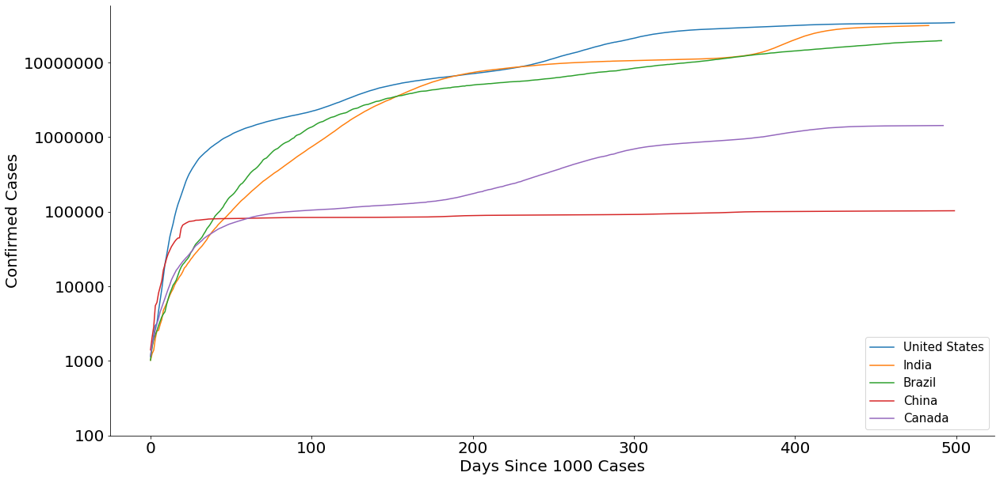

In [135]:
#Plot the line chart with df_line and adjust the axis
fig, ax1 = plt.subplots(figsize=(20,10))
sns.lineplot(x="ds1000", y="log10_CC", ax=ax1,
             hue="Country", markers=True, dashes=False,
              data=df_line[(df_line.ds1000<500)])

ax1.tick_params(labelsize=20)
ax1.legend(loc='lower right', prop={'size': 15})
ax1.set_xlabel('Days Since 1000 Cases', fontsize=20)
ax1.set_ylabel('Confirmed Cases', fontsize=20)

yticks = [2, 3, 4, 5, 6, 7]
ax1.set_yticks(yticks)
ax1.set_yticklabels([100, 1000, 10000, 100000, 1000000, 10000000])

sns.despine()